**Pressione SHIFT+ENTER para executar a célula**

# Alegrete

Este notebook fornece algumas visualizações para o trabalho de regressão linear. Para conseguir usar, implemente as funções no seu `alegrete.py` e tenha as bibliotecas `numpy` e `matplotlib` instaladas.

O notebook usa um conjunto de dados sintetico. Adapte-o para carregar e usar os dados do `alegrete.csv`.

### Imports das bibliotecas de plot e da solucao implementada

In [1]:
%matplotlib inline
from IPython.display import HTML
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

import alegrete

### Visualizacao dos dados

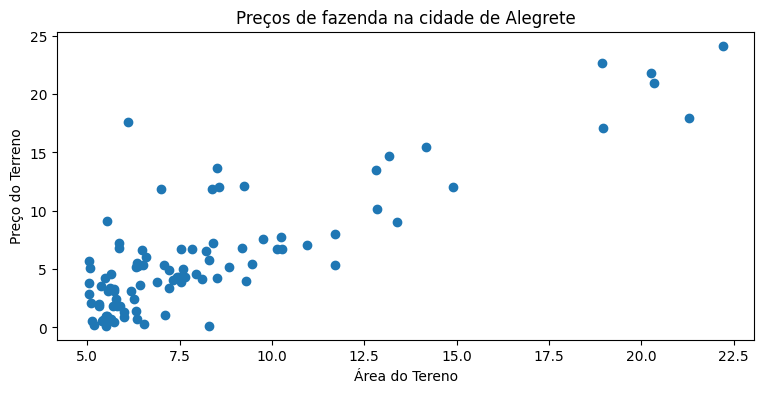

In [2]:
dados = np.genfromtxt('alegrete.csv', delimiter=',')

tamanho_terreno = dados[:, 0]
preco = dados[:, 1] 

#Gráfico dos dados
plt.figure(figsize=(9, 4))
plt.scatter(tamanho_terreno, preco)
plt.xlabel('Área do Tereno')
plt.ylabel('Preço do Terreno')
plt.title('Preços de fazenda na cidade de Alegrete')
plt.show()

### Execucao da regressao linear e calculo do EQM por epoca/iteracao

Considere o parâmetro b o coeficiente linear (theta_0, visto em aula) e w o coeficiente angular (theta_1, visto em aula).

-3.4500309083495133 1.1606252083278805
EQM final: 8.527708190983812


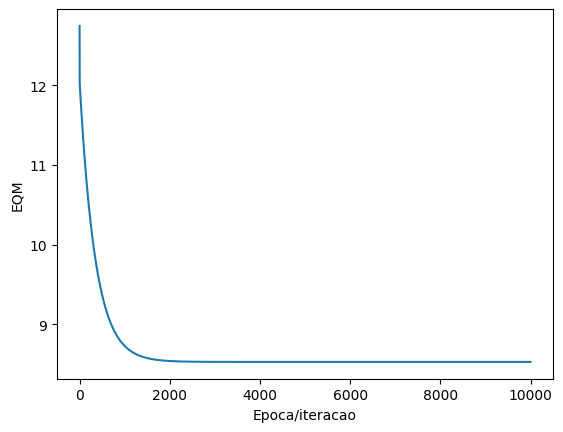

In [3]:
# import importlib
# import alegrete

# # Forçar o recarregamento do módulo alegrete
# importlib.reload(alegrete)

b_history, w_history = alegrete.fit(dados, b=1, w=1,alpha=0.004, num_iterations=10000)


# valores finais de theta0 e theta1
final_b, final_w = b_history[-1], w_history[-1]

print(final_b,final_w)

mse_list = [alegrete.compute_mse(b, w, dados) for b, w in zip(b_history, w_history)]
print(f"EQM final: {mse_list[-1]}")


plt.plot(mse_list)
plt.xlabel('Epoca/iteracao')
plt.ylabel('EQM')
plt.show()

### Plot da curva final

Curva encontrada: 1.1606252083278805*x + -3.4500309083495133


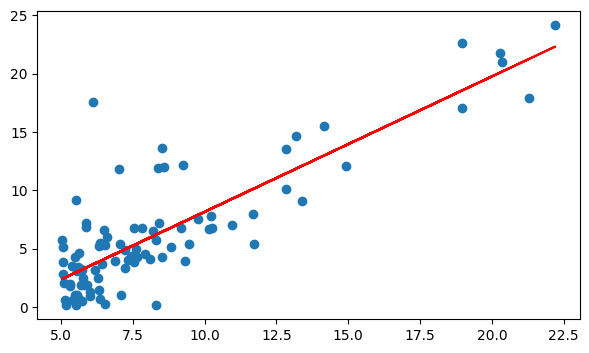

In [4]:
#Imprimir parâmetros otimizados
print (f'Curva encontrada: {final_w}*x + {final_b}')

#plota os dados
plt.figure(figsize=(7, 4))
plt.scatter(dados[:,0], dados[:,1])

# plota a curva de ajuste
pred = final_w*dados[:,0] + final_b
plt.plot(dados[:,0], pred, c='r')
plt.show()





### Progresso da descida do gradiente com o número de iterações

Execute a celula e use os controles abaixo do grafico para visualizar o progresso do seu ajuste

Pode aparecer um grafico "extra" abaixo da animacao, apenas ignore.

C:\Users\duduf\AppData\Local\Temp\ipykernel_23364\535459215.py:18: UserWarning: You passed in an explicit save_count=50 which is being ignored in favor of frames=10000.
  ani = animation.FuncAnimation(fig, animate, frames=len(b_history), interval=50, save_count=50)
Animation size has reached 20992055 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


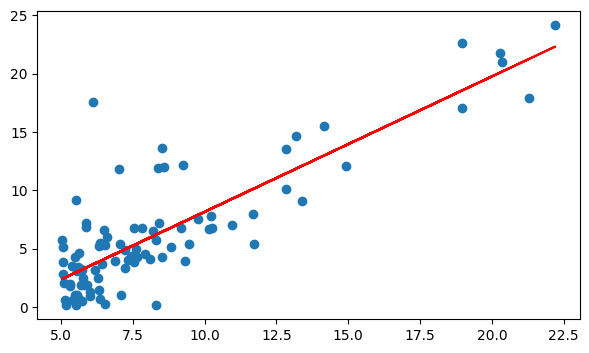

In [5]:
fig = plt.figure(figsize=(7, 4))
ax = fig.add_subplot(111)

# conjunto de dados
ax.scatter(dados[:,0], dados[:,1])

# # linha com os valores iniciais dos parametros
pred = w_history[0]*dados[:,0] + b_history[0]
line, = ax.plot(dados[:,0], pred, '-',c='r')

# funcao que atualiza a linha a cada passo
def animate(i):
    pred = w_history[i] * dados[:,0] + b_history[i]
    line.set_ydata(pred)
    return line,

# mude interval para trocar a velocidade da animacao
ani = animation.FuncAnimation(fig, animate, frames=len(b_history), interval=50, save_count=50)
HTML(ani.to_jshtml())